In [1]:
import os
import pandas as pd
import librosa
import numpy as np
import IPython.display as ipd
import torchaudio
import librosa.display
import matplotlib.pyplot as plt
import random
import string
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from gensim import models


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# Define the paths to the data directories
BASE_DIR = '/kaggle/input/bengaliai-speech'
train_data_dir = f"{BASE_DIR}/train_mp3s/"  
test_data_dir = f"{BASE_DIR}/test_mp3s/" 
train_csv_path = f"{BASE_DIR}/train.csv" 
domains = f"{BASE_DIR}/examples/" 

# Load the train.csv file using pandas
train_df = pd.read_csv(train_csv_path)

# Preview the first few rows of the DataFrame
train_df.head()

,id,sentence,split
0,000005f3362c,ও বলেছে আপনার ঠিকানা!,train
1,00001dddd002,কোন মহান রাষ্ট্রের নাগরিক হতে চাও?,train
2,00001e0bc131,"আমি তোমার কষ্টটা বুঝছি, কিন্তু এটা সঠিক পথ না।",train
3,000024b3d810,নাচ শেষ হওয়ার পর সকলে শরীর ধুয়ে একসঙ্গে ভোজন...,train
4,000028220ab3,"হুমম, ওহ হেই, দেখো।",train


In [3]:
#Domains
#DOMAINS= !ls/kaggle/input/bengaliai-speech/examples/
DOMAINS= !ls /kaggle/input/bengaliai-speech/examples
DOMAINS

['Audiobook.wav',
 'Bangladeshi TV Drama.wav',
 'Bengali Advertisement.wav',
 'Cartoon.wav',
 'Debate.wav',
 'Indian TV Drama.wav',
 'Movie.wav',
 'News Presentation.wav',
 'Online Class.wav',
 'Parliament Session.wav',
 'Poem Recital.wav',
 'Puthi Literature.wav',
 'Slang Profanity.mp3',
 'Stage Drama Jatra.wav',
 'Talk Show Interview.wav',
 'Telemedicine.mp3',
 'Waz Islamic Sermon.wav']

In [4]:
#Load audio file and corresponding transcriptions 

audio_data=[] #list to store audio data 
transcriptions = [] #list to store corresponding transcription

for idx, row in train_df.head(5).iterrows():
    audio_file_path=os.path.join(train_data_dir,f"{row['id']}.mp3")
    
    #load the audio file using librosa
    audio,sr=librosa.load(audio_file_path,sr=None)
    
    #append audio data and transcription to list 
    
    audio_data.append(audio)
    transcriptions.append(row['sentence'])
    
    
audio_data= np.array(audio_data,dtype='object')
transcriptions=np.array(transcriptions, dtype='object')

#check the shape of the loaded data 
print("Audio data shape:",audio_data.shape)
print('Transcription shape:',transcriptions.shape)

Audio data shape: (5,)
Transcription shape: (5,)


In [5]:
#Get the total number of audio files in the traing and test directory 

train_audio_files=os.listdir(train_data_dir)
test_audio_files=os.listdir(test_data_dir)


#get the total duration of audion data in the traing set(in second)

train_total_duration=0
for idx, row in train_df.head(10).iterrows():
    audio_file_path=os.path.join(train_data_dir,f"{row['id']}.mp3")
    audio_info=torchaudio.info(audio_file_path)
    duration=audio_info.num_frames/ audio_info.sample_rate
    train_total_duration += duration
    
    
#Get the number of unique domains present in the traing data 

unique_domains= train_df['split'].unique()

#Get the total number of samples in the training data 
total_samples=train_df.shape[0]

#print the data summary

print("Data Summary:")
print(f"Total number of audio files in the training directory :{len(train_audio_files)}")
print(f"Total number of audio files in the test directory :{len(test_audio_files)}")
print(f"Total duration of audio data in the training set (in seconds):{train_total_duration:.2f}")
print(f"Number of unique domains in the training data: {unique_domains}")
print(f"Total number of samples in the training data: {total_samples}")
    
    

Data Summary:
Total number of audio files in the training directory :963636
Total number of audio files in the test directory :3
Total duration of audio data in the training set (in seconds):51.48
Number of unique domains in the training data: ['train' 'valid']
Total number of samples in the training data: 963636


In [6]:
#Listen

#choose some random indices for checking

random_indices=[0,10,20,100,400]

for idx in random_indices:
    row=train_df.iloc[idx]
    audio_file_path=os.path.join(train_data_dir, f"{row['id']}.mp3")
    
    #load the audio file using librosa 
    audio,sr=librosa.load(audio_file_path, sr=None)
    
    
    #print the transcription and play the audio
    print("Transcription:",row['sentence'])
    ipd.display(ipd.Audio(audio, rate=sr))

Transcription: ও বলেছে আপনার ঠিকানা!


Transcription: কিন্তু অঙ্গ কর্তন কিংবা হত্যা করা পর্যন্ত তা গড়াতো না।


Transcription: তিনি এবং তাঁর মা তাদের পৈতৃক বাড়িতে থেকে প্রতিবেশীদের দ্বারা অনেক তিরস্কার সহ্য করেন।


Transcription: তিনি তার সুশৃঙ্খল সামরিক বাহিনী এবং সুগঠিত শাসন কাঠামোর মাধ্যমে একটি দক্ষ শাসন ব্যবস্থা প্রতিষ্ঠিত করেন।


Transcription: জান্নাত আমাদের জন্য অপেক্ষা করছে, ভাই।


# Visualization

In [7]:
#Visualization 
domain_counts=train_df['split'].value_counts()
domain_counts

train    934048
valid     29588
Name: split, dtype: int64

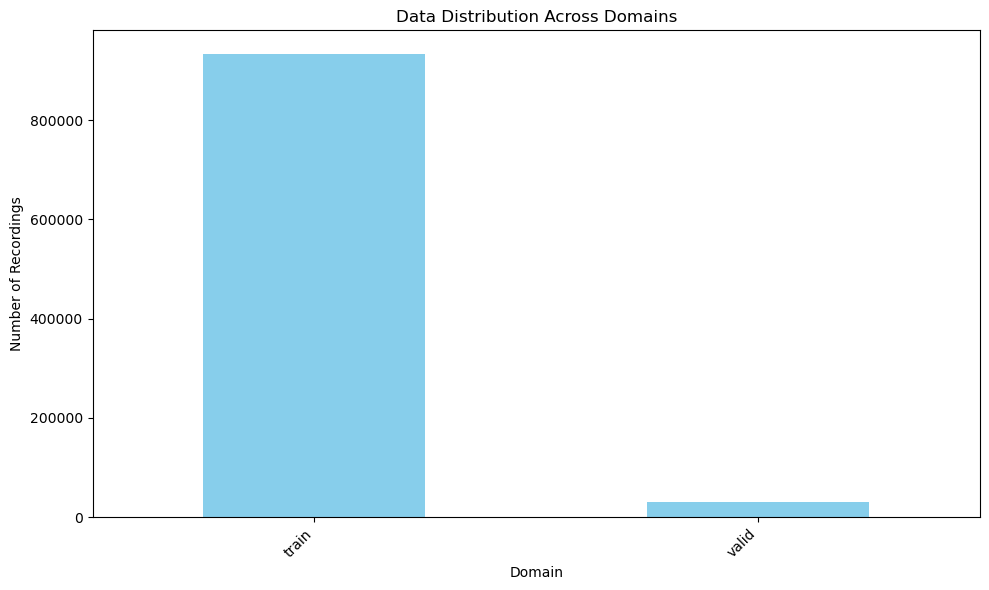

In [8]:
#plot the data distribution 
plt.figure(figsize=(10,6))
domain_counts.plot.bar(color='skyblue')
plt.title("Data Distribution Across Domains")
plt.xlabel("Domain")
plt.ylabel("Number of Recordings")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

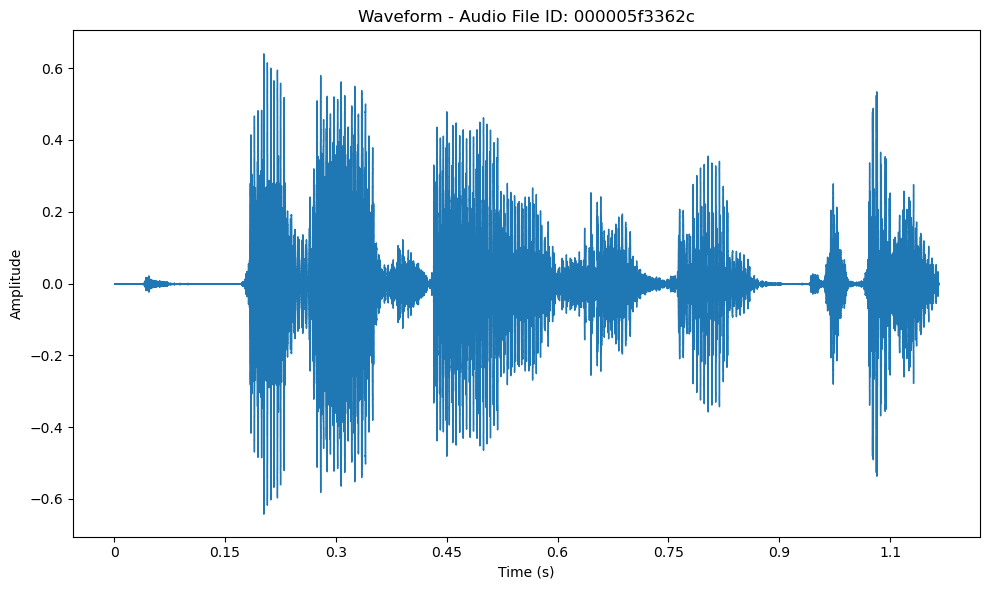

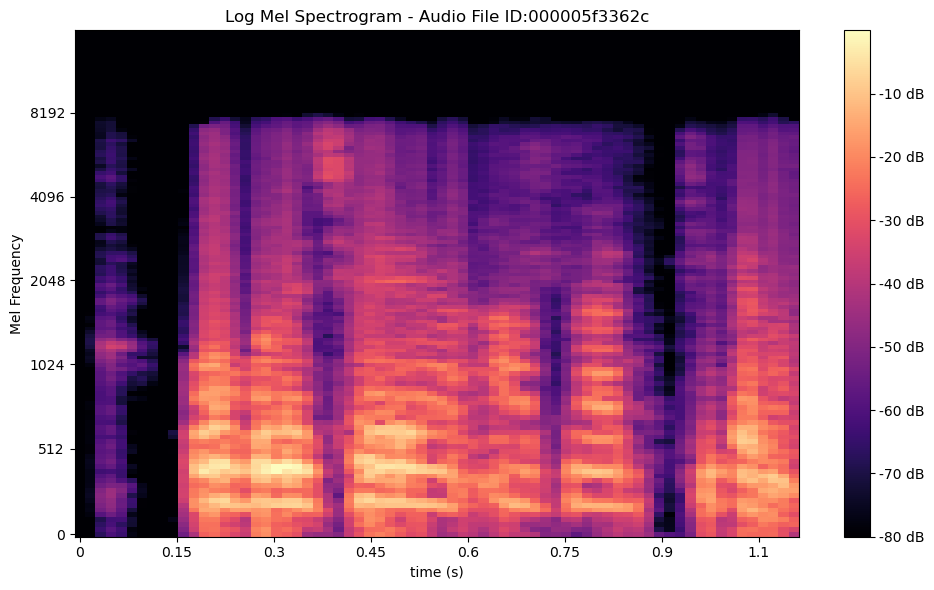

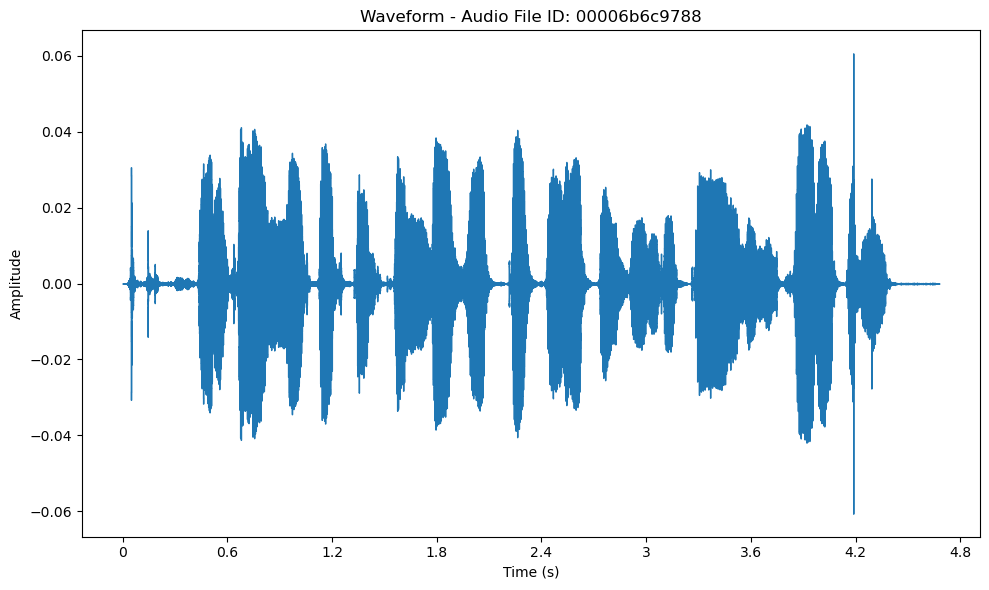

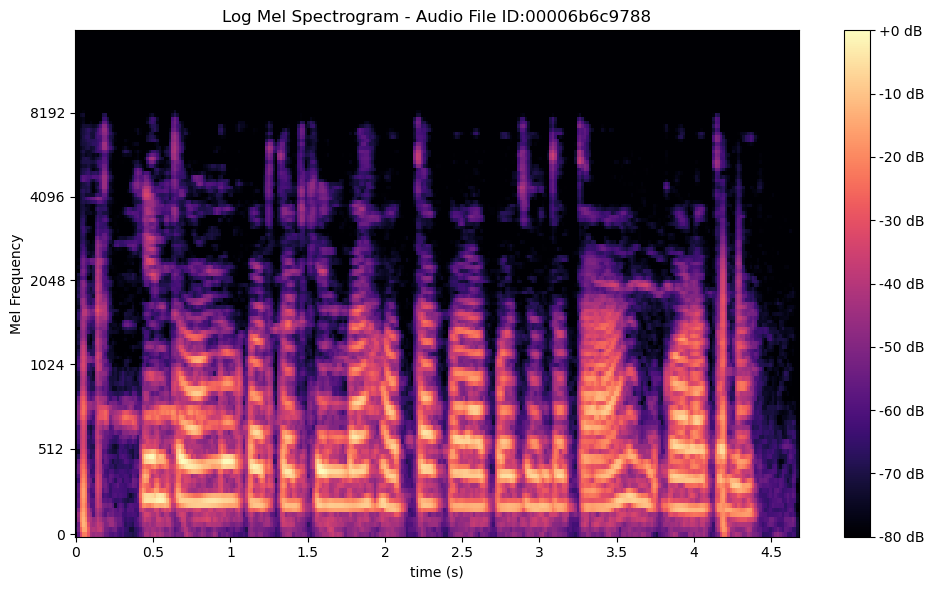

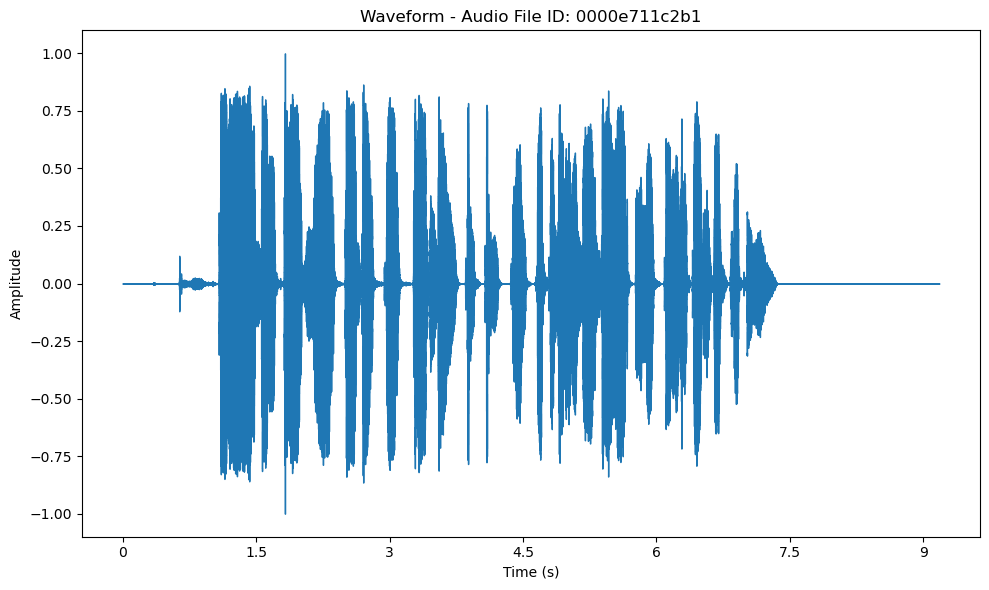

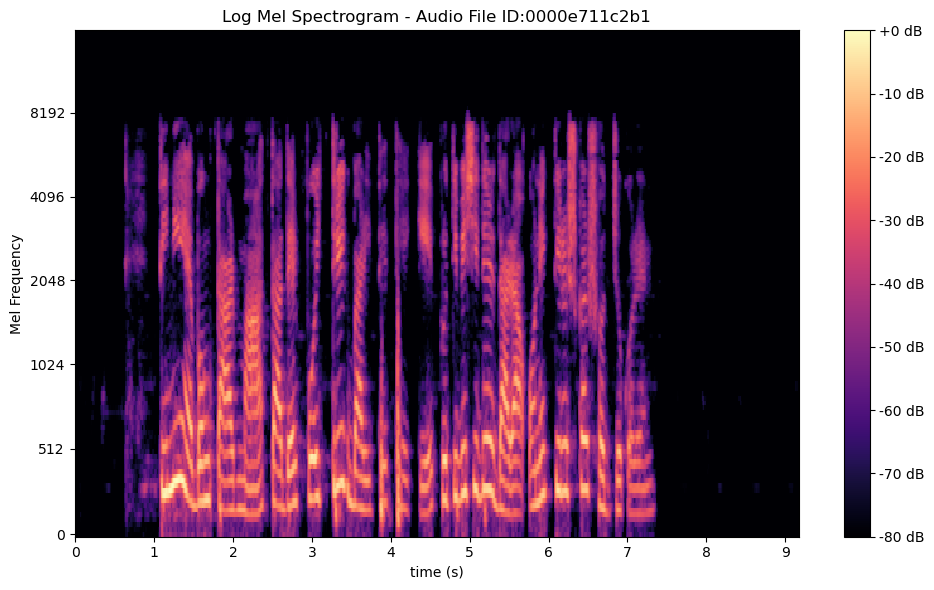

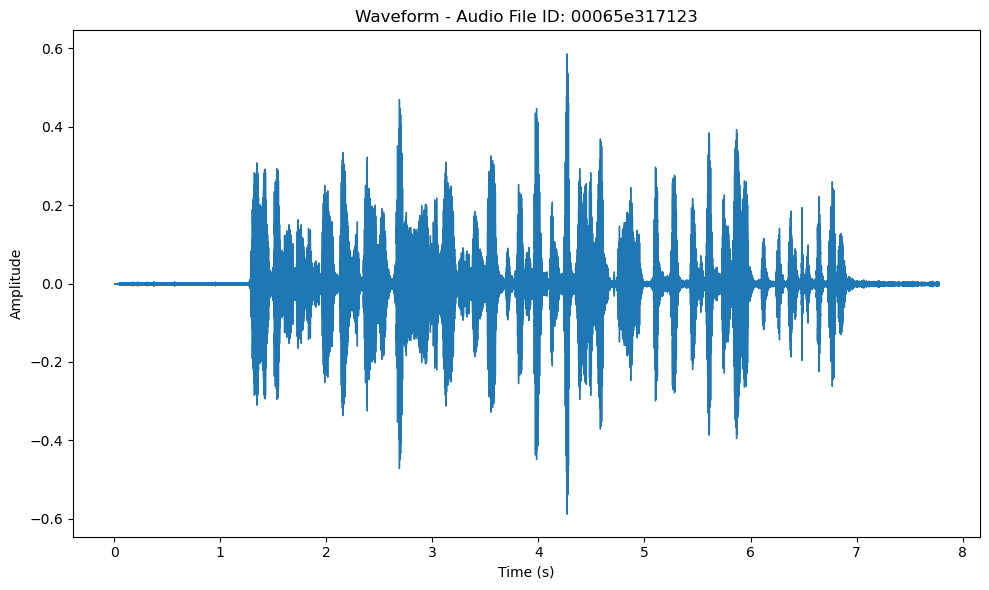

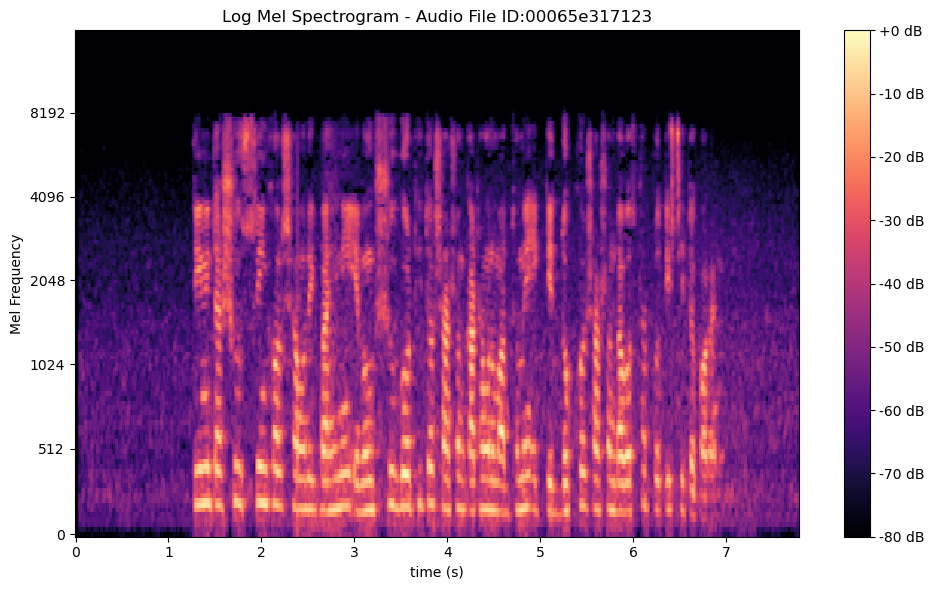

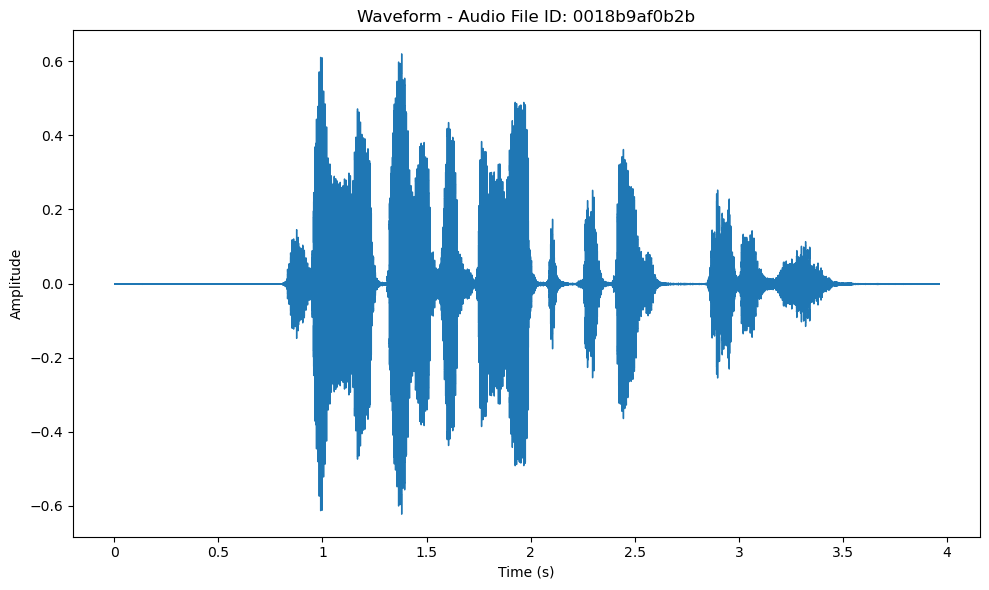

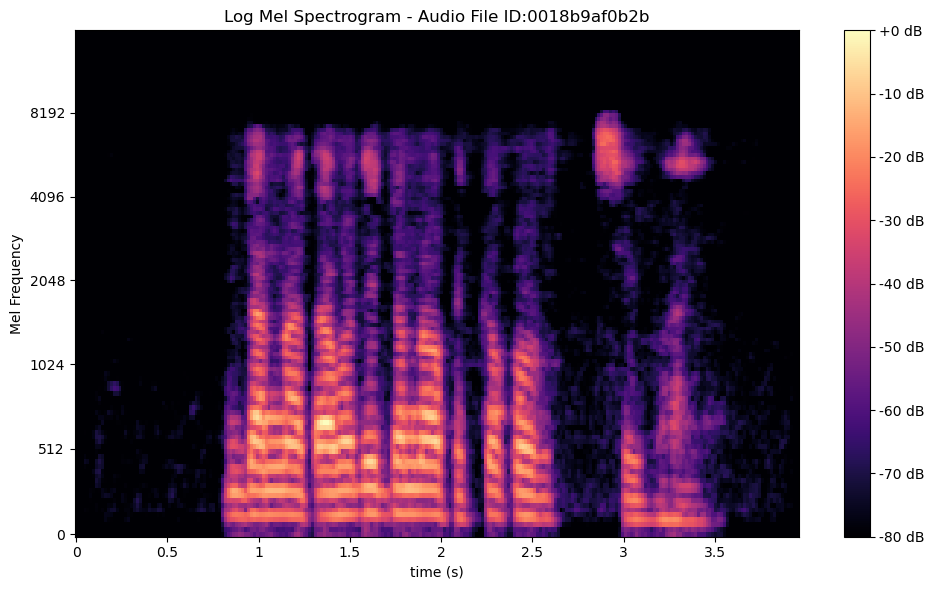

In [9]:
for idx in random_indices:
    row=train_df.iloc[idx]
    audio_file_path=os.path.join(train_data_dir, f"{row['id']}.mp3")
    
    #load the audio file using librosa 
    audio,sr=librosa.load(audio_file_path, sr=None)
    
    
    #plot the waveform
    plt.figure(figsize=(10,6))
    librosa.display.waveshow(audio,sr=sr)
    plt.title(f"Waveform - Audio File ID: {row['id']}")
    plt.xlabel("Time (s)")
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()
    
    
    #plot the log Mel spectrogram
    
    plt.figure(figsize=(10,6))
    mel_spec=librosa.feature.melspectrogram(y=audio, sr=sr)
    mel_spec_db= librosa.power_to_db(mel_spec, ref=np.max)
    librosa.display.specshow(mel_spec_db, sr=sr, x_axis='time',y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"Log Mel Spectrogram - Audio File ID:{row['id']}")
    plt.xlabel("time (s)")
    plt.ylabel("Mel Frequency")
    plt.tight_layout()
    plt.show()

# Text Preprocessing

In [10]:
#Select the first 5 transcriptions
transcriptions=train_df['sentence'][:5].tolist()

#Covert transcriptions to lowercase

transcriptions_lower= [transcription.lower() for transcription in transcriptions]

#Remove punction 
translator= str.maketrans("","",string.punctuation)
transcriptions_no_punct=[transcription.translate(translator) for transcription in transcriptions_lower]

#Tokenization

nltk.download('punkt')
transcriptions_tokens = [word_tokenize(transcription) for transcription in transcriptions_no_punct]

nltk.download('stopwords')
stop_words=set(stopwords.words('bengali'))
transcription_no_stopwords=[
    [word for word in tokens if word not in stop_words]
    for tokens in transcriptions_tokens
]

nltk.download('wordnet')  
stemmer = PorterStemmer()
transcriptions_stemmed = [
    [stemmer.stem(word) for word in tokens]
    for tokens in transcription_no_stopwords
]


#print the preprocessed transcriptions
for i, transcription in enumerate(transcriptions_stemmed):
    print(f"Preprocessed transcription {i+1}: {' '.join(transcription)}")

[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
Preprocessed transcription 1: বলেছে ঠিকানা
Preprocessed transcription 2: মহান রাষ্ট্রের নাগরিক চাও
Preprocessed transcription 3: কষ্টটা বুঝছি সঠিক পথ না।
Preprocessed transcription 4: নাচ শেষ সকলে শরীর ধুয়ে একসঙ্গে ভোজন করেন।
Preprocessed transcription 5: হুমম ওহ হেই দেখো।


# Tokenization

In [11]:
# Select the first 100 transcriptions 
transcriptions= train_df['sentence'][:100].tolist()

#Tokenization 
nltk.download('punkt')
transcriptions_tokens=[word_tokenize(transcription) for transcription in transcriptions]

#Print the tokenized transcriptions

for i, transcription_tokens in enumerate(transcriptions_tokens):
    if i%10==0:
        print(f"Tokensized transcription {i+1}:{transcription_tokens}")
        

[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
Tokensized transcription 1:['ও', 'বলেছে', 'আপনার', 'ঠিকানা', '!']
Tokensized transcription 11:['কিন্তু', 'অঙ্গ', 'কর্তন', 'কিংবা', 'হত্যা', 'করা', 'পর্যন্ত', 'তা', 'গড়াতো', 'না।']
Tokensized transcription 21:['তিনি', 'এবং', 'তাঁর', 'মা', 'তাদের', 'পৈতৃক', 'বাড়িতে', 'থেকে', 'প্রতিবেশীদের', 'দ্বারা', 'অনেক', 'তিরস্কার', 'সহ্য', 'করেন।']
Tokensized transcription 31:['প্রাথমিকভাবে', 'একজন', 'ইউজিসি', 'অধ্যাপক', 'দুই', 'বছরের', 'জন্য', 'নিযুক্ত', 'হন।']
Tokensized transcription 41:['তিনি', 'ক্ষীরসাগরের', 'নিচে', 'নিজেকে', 'স্থাপন', 'করে', 'মন্দার', 'পর্বতকে', 'পৃষ্ঠদেশে', 'ধারণ', 'করেন।']
Tokensized transcription 51:['তার', 'পরে', 'প্রজাপতির', 'নির্বন্ধ।']
Tokensized transcription 61:['বিদেশিদের', 'ওপর', 'হামলা', 'বৈশ্বিক', 'সংবাদ', 'শিরোনামে', 'সহজেই', 'স্থান', 'পায়—এটিই', 'হচ্ছে', 'প্রচলিত', 'ধারণা।']
Tokensized transcription 71:['মহাজন', 'সময়', 'বুঝিয়া', 'ডিক্রীজারি', 'করি

# Vocab Analysis

In [12]:
#Build vocabulary


vocabulary=set()
for transcription_tokens in transcriptions_tokens:
    vocabulary.update(transcription_tokens)
    
    
print(f"Vocabulary SIze:{len(vocabulary)}")    
    

Vocabulary SIze:721


(array([1.46812e+05, 3.01428e+05, 2.76002e+05, 1.89254e+05, 3.83470e+04,
        1.00420e+04, 1.62200e+03, 1.13000e+02, 1.10000e+01, 5.00000e+00]),
 array([  2. ,  25.1,  48.2,  71.3,  94.4, 117.5, 140.6, 163.7, 186.8,
        209.9, 233. ]),
 <BarContainer object of 10 artists>)

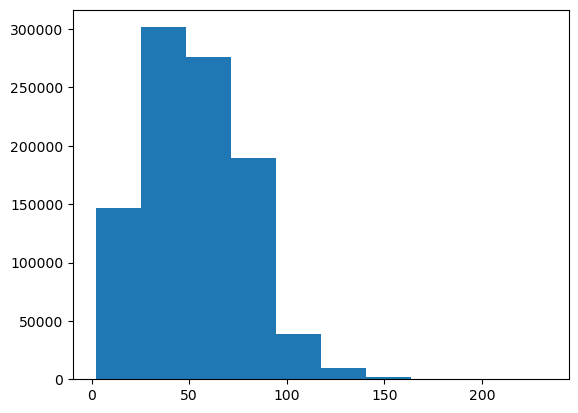

In [13]:
lens=train_df.sentence.apply(lambda x: len(x))
plt.hist(lens)

Average sentence length:9.41
Maximum sentence length:25


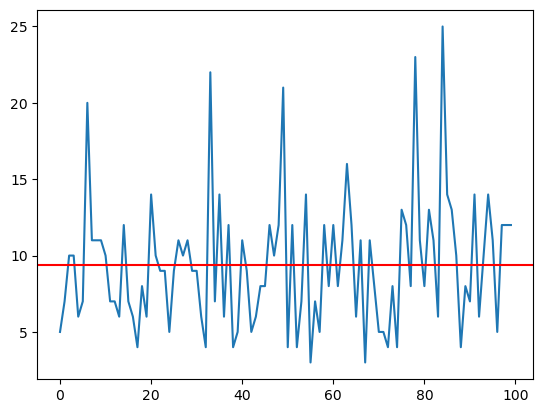

In [14]:
#calculate sentence lengths

sentence_lengths =[len(tokens) for tokens in transcriptions_tokens]

#calculate average and maximum sentence lengths

average_length= sum(sentence_lengths)/len(sentence_lengths)
max_length=max(sentence_lengths)

#print the sentence length 

print(f"Average sentence length:{average_length}")
print(f"Maximum sentence length:{max_length}")

plt.plot(sentence_lengths)
plt.axhline(average_length, c='red')

# Word frequency Analysis


world frequency :


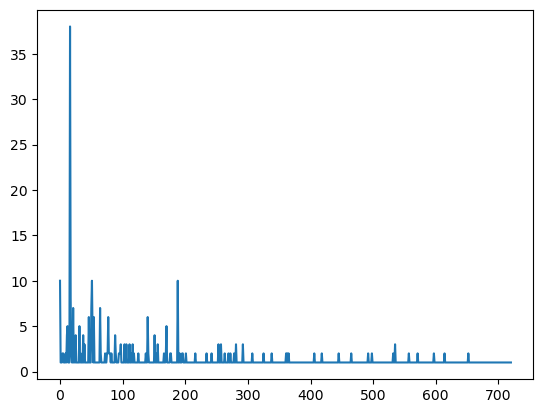

In [15]:
# Flateen the list of tokens 
all_tokens=[token for tokens in transcriptions_tokens for token in tokens]

#count word frequency 
word_frequency= Counter(all_tokens)

#print the world frequency analysis 
print("world frequency :")
plt.plot(word_frequency.values())

# Topic Modeling

In [16]:
for  idx in np.arange(5):
    audio_file_path=f'{domains}/{DOMAINS[idx]}'
    
    #load the audio file using librosa
    audio,sr=librosa.load(audio_file_path,sr=None)
    
    #print DOMAIN
    print (DOMAINS[idx])
    ipd.display(ipd.Audio(audio,rate=sr))

Audiobook.wav


Bangladeshi TV Drama.wav


Bengali Advertisement.wav


Cartoon.wav


Debate.wav


In [17]:
# Select the first 1000 sentences 
sentences = train_df['sentence'][:10000].tolist()

# Tokenization using NLTK
nltk.download('punkt')  # Download the Punkt tokenizer
sentences_tokens = [word_tokenize(sentence) for sentence in sentences]


# Remove Bengali stopwords
sentences_no_stopwords = [
    [word for word in tokens if word not in stop_words]
    for tokens in sentences_tokens
]

# Convert tokenized sentences back to strings
sentences_processed = [' '.join(tokens) for tokens in sentences_no_stopwords]

# Create a CountVectorizer to convert text data to a bag-of-words representation
vectorizer = CountVectorizer(max_features=1000)
X = vectorizer.fit_transform(sentences_processed)

# Perform LDA topic modeling
n_topics = 10  # Number of topics to discover
lda_model = LatentDirichletAllocation(n_components=n_topics, random_state=42)
lda_model.fit(X)

# Get the top words for each topic
feature_names = vectorizer.get_feature_names_out()
top_words_per_topic = []
for topic_idx, topic in enumerate(lda_model.components_):
    top_words = [feature_names[i] for i in topic.argsort()[:-4:-1]]
    top_words_per_topic.append(top_words)

# Print the top words for each topic
for i, top_words in enumerate(top_words_per_topic):
    print(f"Topic {i + 1}: {' '.join(top_words)}")
    

[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
Topic 1: কর একট লন
Topic 2: অন অভ বর
Topic 3: কর হত লত
Topic 4: হয় বন রত
Topic 5: বল কথ একজন
Topic 6: পর কর রণ
Topic 7: এক সক নয়
Topic 8: আছ চল সম
Topic 9: হব ওয় রব
Topic 10: কল অবস তর


In [18]:
lda_model.components_

array([[ 7.84353042,  0.10001465,  0.1       , ...,  0.1000081 ,
         0.10001306,  0.10000844],
       [ 0.18392509,  0.10001484,  0.10000863, ...,  0.10000848,
        17.80846538,  2.09993854],
       [ 0.10000538,  5.28395336, 15.03105365, ...,  8.70772598,
         0.10000629,  0.10000097],
       ...,
       [ 0.1000041 ,  0.10001168,  2.16892265, ...,  0.10000554,
         0.10000111,  0.1       ],
       [ 0.10000649,  0.1       ,  0.10000183, ...,  0.10000847,
         0.10001288,  7.09999678],
       [ 0.87740581,  5.36809906,  0.10000491, ...,  0.35530223,
         0.10000637,  0.10001745]])